In [2]:
import os
import matplotlib.pyplot as plt
import numpy as np
from ultralytics import YOLO
import tensorflow as tf
import torch
from yolov5.models.yolo import Model
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from PIL import Image
import torch.optim as optim
from torchvision.transforms import v2

# Pretraining

In [ ]:
for dirname, _, filenames in os.walk('./data/'):
    for filename in filenames:
        pass

In [ ]:
#will before we do anything we will need ultralytics so lets pip install that
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [ ]:
# Lets now train our model
with tf.device("/GPU"): #this will force the note book to use the GPU
    model = YOLO("yolov5n.yaml")
    results = model.train(data=os.getcwd()+"/data/datayaml.yaml", epochs=2)
    torch.save(model.model.state_dict(), './mymodel.pth')


                   from  n    params  module                                       arguments                     
  0                  -1  1      1760  ultralytics.nn.modules.conv.Conv             [3, 16, 6, 2, 2]              
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      4800  ultralytics.nn.modules.block.C3              [32, 32, 1]                   
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     29184  ultralytics.nn.modules.block.C3              [64, 64, 2]                   
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  3    156928  ultralytics.nn.modules.block.C3              [128, 128, 3]                 
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

100%|██████████| 6.23M/6.23M [00:00<00:00, 37.1MB/s]


AMP: checks passed ✅


train: Scanning C:\Users\priya\OneDrive - Johns Hopkins\Deep Learning\FinalProject\data\train\labels.cache... 5805 images, 93 backgrounds, 0 corrupt: 100%|██████████| 5805/5805 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning C:\Users\priya\OneDrive - Johns Hopkins\Deep Learning\FinalProject\data\valid\labels.cache... 549 images, 8 backgrounds, 0 corrupt: 100%|██████████| 549/549 [00:00<?, ?it/s]


Plotting labels to runs\detect\train7\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\train7
Starting training for 2 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/2      3.21G      3.456      3.502      3.162        225        640: 100%|██████████| 363/363 [00:58<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.53it/s]

                   all        549       6270      0.294      0.105     0.0846     0.0376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/2      3.55G      2.232      2.068      1.871        191        640: 100%|██████████| 363/363 [00:51<00:00,  7.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:04<00:00,  4.07it/s]

                   all        549       6270      0.402      0.336      0.291      0.141



2 epochs completed in 0.034 hours.
Optimizer stripped from runs\detect\train7\weights\last.pt, 5.3MB
Optimizer stripped from runs\detect\train7\weights\best.pt, 5.3MB

Validating runs\detect\train7\weights\best.pt...
Ultralytics YOLOv8.0.219 🚀 Python-3.11.6 torch-2.1.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
YOLOv5n summary (fused): 193 layers, 2503919 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.11it/s]


                   all        549       6270      0.403      0.337      0.291      0.142
               bicycle        549        250      0.114      0.392      0.234      0.108
                   bus        549        108      0.924      0.112      0.272      0.136
                   car        549       3842      0.464      0.715      0.671      0.362
             motorbike        549       1238      0.331      0.196      0.157     0.0627
                person        549        832      0.183      0.268      0.123     0.0392
Speed: 0.1ms preprocess, 1.7ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs\detect\train7


In [ ]:
# Load the model configuration
model = Model('./yolov5/models/yolov5n.yaml')

# Load the pre-trained weights
model_path = './mymodel.pth'
pretrained_dict = torch.load(model_path)

# Update model's state dict
model.load_state_dict(pretrained_dict, strict=False)

# Set the model to evaluation mode
model.eval()


                 from  n    params  module                                  arguments                     
  0                -1  1      1760  yolov5.models.common.Conv               [3, 16, 6, 2, 2]              
  1                -1  1      4672  yolov5.models.common.Conv               [16, 32, 3, 2]                
  2                -1  1      4800  yolov5.models.common.C3                 [32, 32, 1]                   
  3                -1  1     18560  yolov5.models.common.Conv               [32, 64, 3, 2]                
  4                -1  2     29184  yolov5.models.common.C3                 [64, 64, 2]                   
  5                -1  1     73984  yolov5.models.common.Conv               [64, 128, 3, 2]               
  6                -1  3    156928  yolov5.models.common.C3                 [128, 128, 3]                 
  7                -1  1    295424  yolov5.models.common.Conv               [128, 256, 3, 2]              
  8                -1  1    296448  

 20                -1  1     74496  yolov5.models.common.C3                 [128, 128, 1, False]          
 21                -1  1    147712  yolov5.models.common.Conv               [128, 128, 3, 2]              
 22          [-1, 10]  1         0  yolov5.models.common.Concat             [1]                           
 23                -1  1    296448  yolov5.models.common.C3                 [256, 256, 1, False]          
 24      [17, 20, 23]  1    115005  yolov5.models.yolo.Detect               [80, [[10, 13, 16, 30, 33, 23], [30, 61, 62, 45, 59, 119], [116, 90, 156, 198, 373, 326]], [64, 128, 256]]
YOLOv5n summary: 214 layers, 1872157 parameters, 1872157 gradients, 4.6 GFLOPs



DetectionModel(
  (model): Sequential(
    (0): Conv(
      (conv): Conv2d(3, 16, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False)
      (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (1): Conv(
      (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (2): C3(
      (cv1): Conv(
        (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (cv2): Conv(
        (conv): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
     

# UNET

In [19]:
class ImageDataset(Dataset):
    def __init__(self, folder_path, transform=None):
        self.folder_path = folder_path
        self.transform = transform
        self.image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        img_name = self.image_files[index]
        img_path = os.path.join(self.folder_path, img_name)
        image = Image.open(img_path).convert("RGB")
        if self.transform is not None:
            image = self.transform(image)
        return image, img_name


# Define transformations, you can modify these as per your need
transform = v2.Compose([
    v2.Resize((256, 256)),
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomVerticalFlip(p=0.5),
    v2.ToTensor()
])

val_transform = v2.Compose([
    v2.Resize((256, 256)),
    v2.ToTensor()
])

# Create the dataset
dataset = ImageDataset(folder_path='./data/train/images/', transform=transform)
valid_dataset = ImageDataset(folder_path="./data/valid/images", transform=val_transform)
test_dataset = ImageDataset(folder_path = './data/test/images/', transform = val_transform)
# Create the DataLoader
data_loader = DataLoader(dataset, batch_size=4, shuffle=True)
valid_loader =DataLoader(valid_dataset, batch_size=1, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=1)
print("Number of batches in the train data loader:", len(data_loader))
print("Number of batches in the valid data loader:", len(valid_loader))
print("Number of batches in the test data loader:", len(test_dataloader))

Number of batches in the train data loader: 1452
Number of batches in the valid data loader: 549
Number of batches in the test data loader: 279


In [4]:
class OutConv(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = torch.nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class DoubleConv(torch.nn.Module):
    """(convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        mid_channels = out_channels // 2  # Adjust the mid_channels based on out_channels
        self.double_conv = torch.nn.Sequential(
            torch.nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(mid_channels),
            torch.nn.ReLU(inplace=True),
            torch.nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Up(torch.nn.Module):
    def __init__(self, in_channels, out_channels, skip_channels=None):
        super(Up, self).__init__()
        self.up = torch.nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        total_in_channels = in_channels + (skip_channels if skip_channels is not None else 0)
        self.double_conv = DoubleConv(total_in_channels, out_channels)

    def forward(self, x, skip=None):
        x = self.up(x)
        if skip is not None:
            # Resize x to match the spatial dimensions of skip
            x = torch.nn.functional.interpolate(x, size=skip.shape[2:], mode='bilinear', align_corners=True)

            # Concatenate along channel dimension
            x = torch.cat([x, skip], dim=1)

        x = self.double_conv(x)
        return x

In [10]:
class YoloEncoder(torch.nn.Module):
    def __init__(self, yolov5_model):
        super(YoloEncoder, self).__init__()
        self.yolov5_model = yolov5_model

    def forward(self, x):
        features = []
        for i, layer in enumerate(self.yolov5_model.model.children()):
            # Check if the layer output is a tuple
            if isinstance(layer(x), tuple):
                # If it's a tuple, you can choose how to handle it
                # For example, just using the first element of the tuple
                x = layer(x)[-1]
            else:
                x = layer(x)

            # Append features or handle them as per your requirement
            if i in [0,1,2,3, 4, 5, 6]:
                features.append(x)
                # print(x.shape)
            if i == 6:
                break

        return features



In [6]:
class UNetWithYoloEncoder(torch.nn.Module):
    def __init__(self, yolov5_encoder, n_classes):
        super(UNetWithYoloEncoder, self).__init__()
        self.encoder = yolov5_encoder
        self.up1 = Up(256, 128, skip_channels=128)  # Upsample to match [4, 128, 32, 32]
        self.up2 = Up(128, 64, skip_channels=128)   # Upsample to match [4, 128, 32, 32]
        self.out_conv = torch.nn.Conv2d(64, n_classes, kernel_size=1)

    def forward(self, x):
        features = self.encoder(x)

        x = features[-1]  # [4, 256, 16, 16]
        x = self.up1(x, features[-3])  # Skip connection: [4, 128, 32, 32]
        x = self.up2(x, features[-4])  # Skip connection: [4, 128, 32, 32]

        x = self.out_conv(x)
        x = torch.nn.functional.interpolate(x, size=(256, 256), mode='bilinear', align_corners=True)
        return x

In [7]:
def imshow_normalized(inp, is_mask=False):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    if not is_mask:
        if inp.max() > 1:
            inp = inp / 255  # Assuming the input is in the range [0, 255]
        inp = np.clip(inp, 0, 1)
    else:
        inp = inp.argmax(axis=2)  # Convert channel-wise predictions to class indices

    plt.imshow(inp, cmap='viridis' if is_mask else None)  # Use a colormap for masks


duque_de_caxias-2565_png_jpg.rf.316b2c2f1e535b59b8cf69677afee01e.jpg


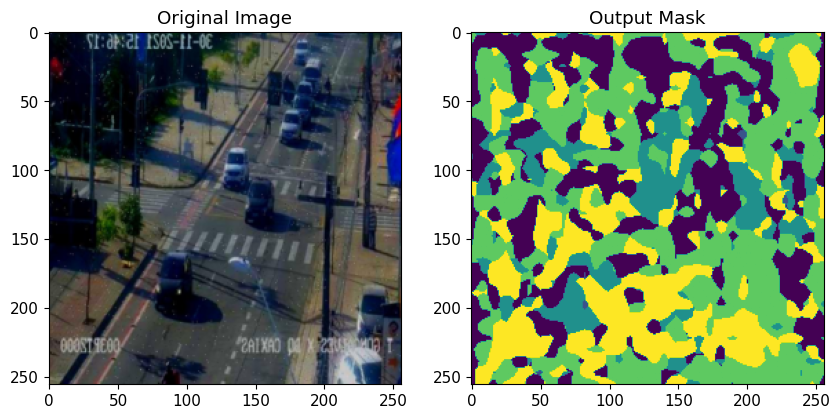

aguanambi-1960_png_jpg.rf.f09d0fd36734056d8635671e51fb158c.jpg


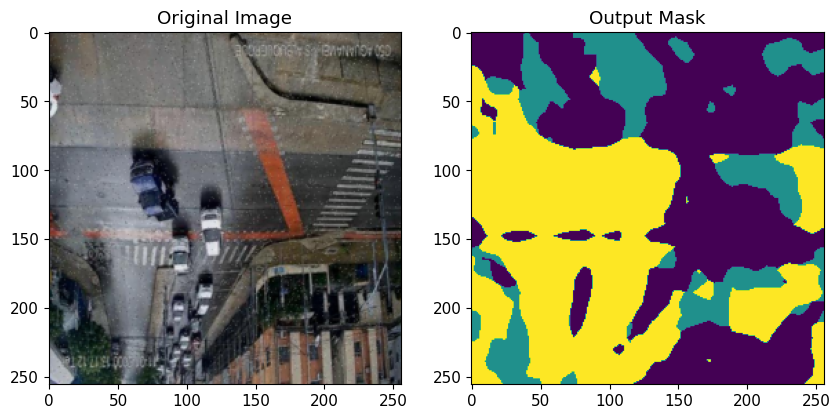

ant_sales-11305_png_jpg.rf.2c62923855c9d2cb2fcc8c624bed39dc.jpg


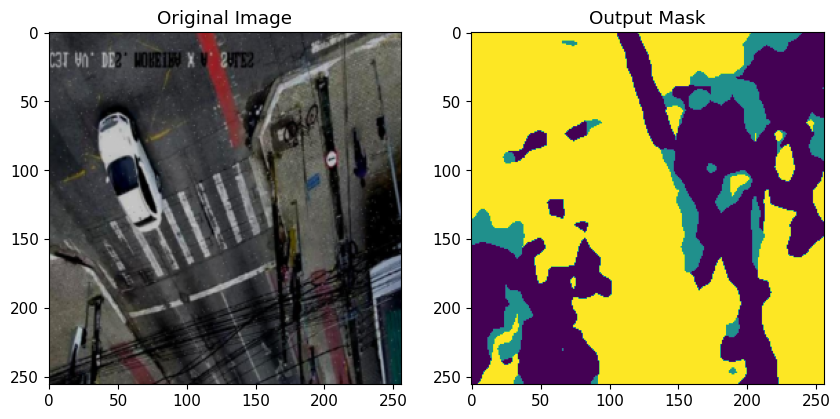

Epoch 1/25, Training Loss: 0.5360, Validation Loss: 0.4473
ant_sales-11170_png_jpg.rf.ecf8e6a50b343fbfeb8e455b2eaf4b48.jpg


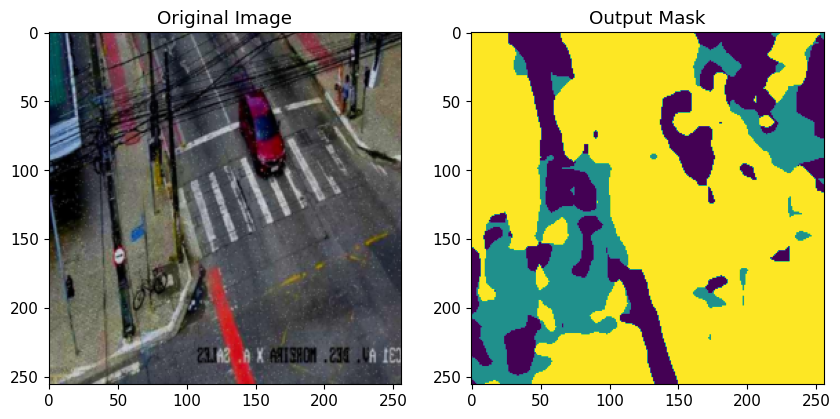

screenshot_15652_jpg.rf.fb73acc792e8e3d1e7fa43808a9ef71f.jpg


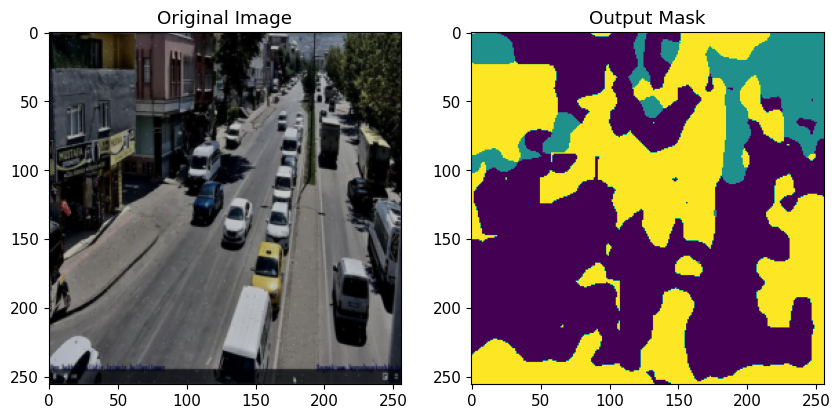

image31_png_jpg.rf.eb9db4d2e7ac94e9e7c02d7a08e29b16.jpg


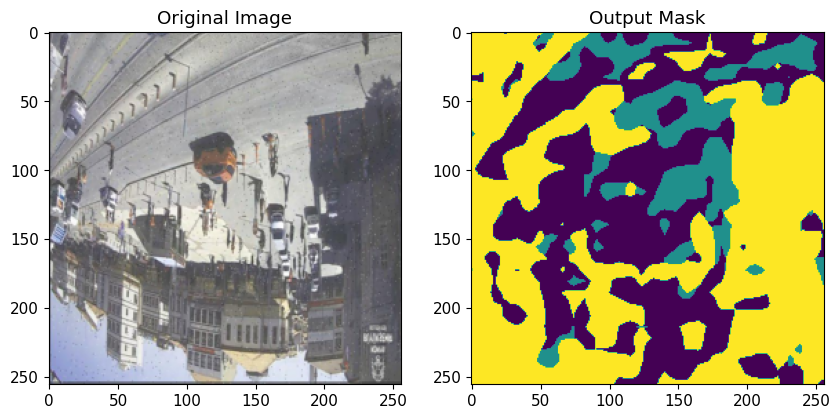

Epoch 2/25, Training Loss: 0.4787, Validation Loss: 0.4126
screenshot_1788_jpg.rf.6edd487d39bcf2db08d51172dede3921.jpg


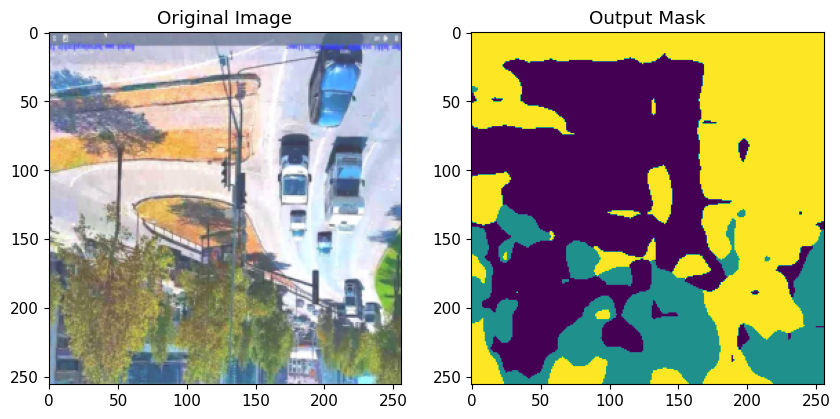

screenshot_22807_jpg.rf.0cf02ac388cf3cffa4beff4d593c1368.jpg


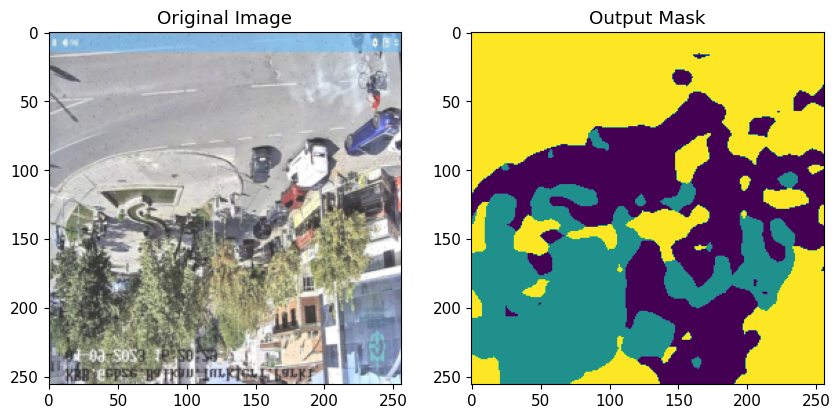

screenshot_8064_jpg.rf.5215bd265926a5f54fb5806d20dd93c7.jpg


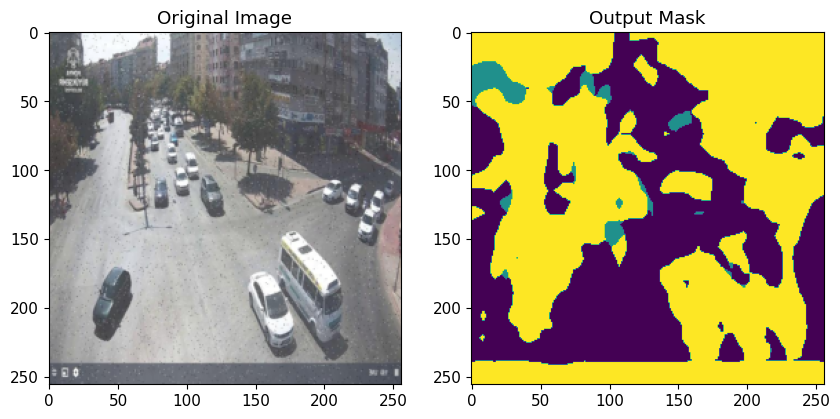

Epoch 3/25, Training Loss: 0.4666, Validation Loss: 0.3854
aguanambi-1235_png_jpg.rf.1fb031a543b18601e956452b0e829404.jpg


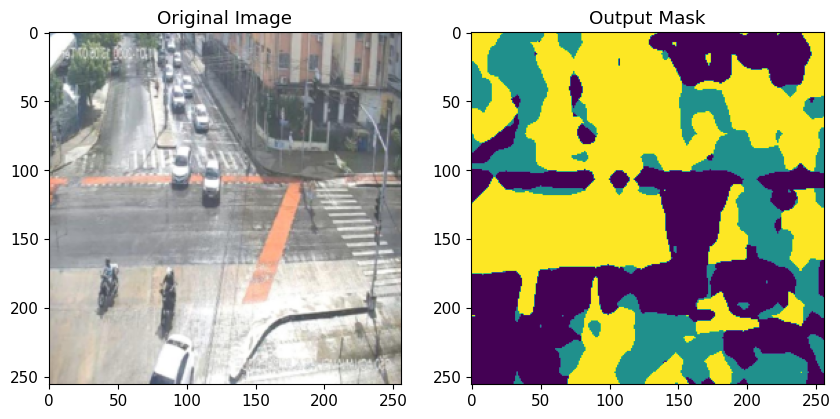

ant_sales-1035_png_jpg.rf.743f52383bf8b6102914aeb743ffb4e0.jpg


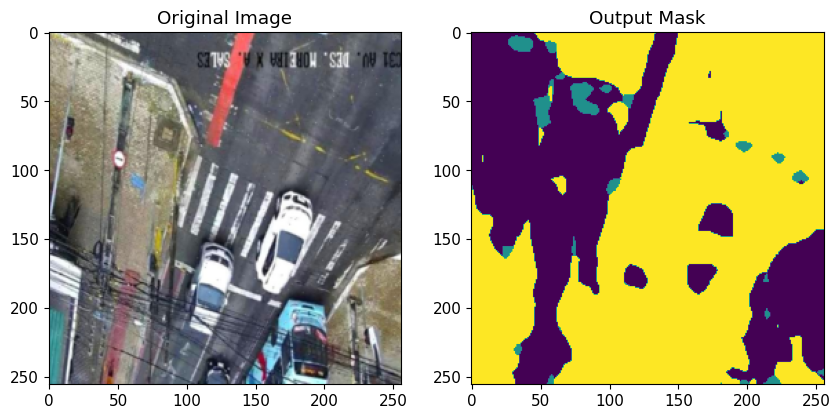

screenshot_299_jpg.rf.70789d4a4493d1ce1b06c0b9d4e04051.jpg


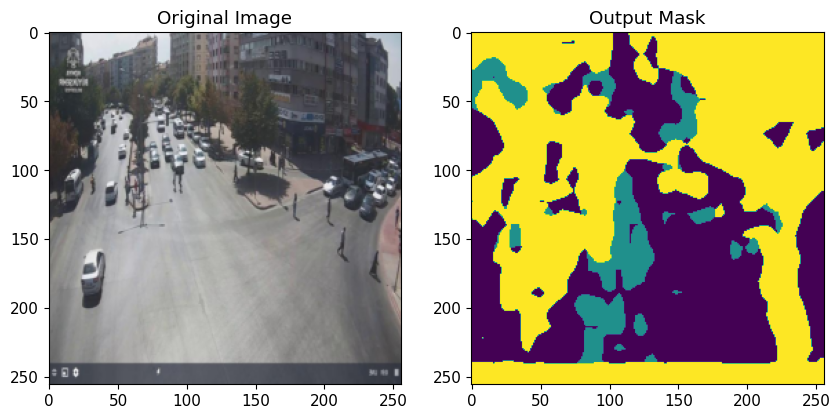

Epoch 4/25, Training Loss: 0.4646, Validation Loss: 0.4025
aguanambi-3980_png_jpg.rf.e0f502c9851ea16d5137f5757696ea27.jpg


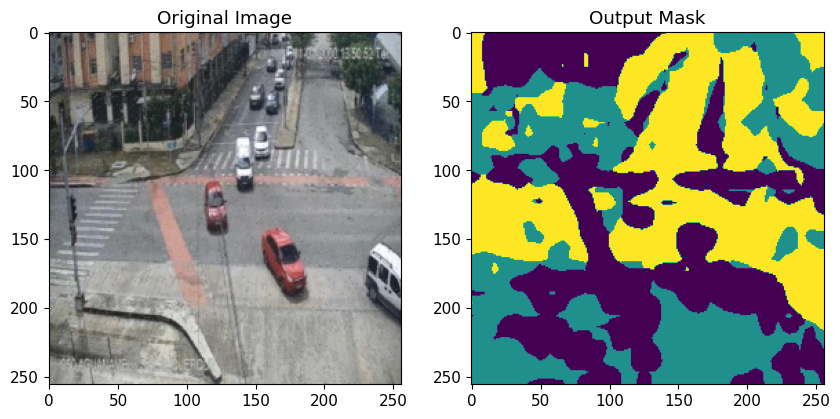

aguanambi-4410_png_jpg.rf.ad54b8d927259520a79e776289d5aaea.jpg


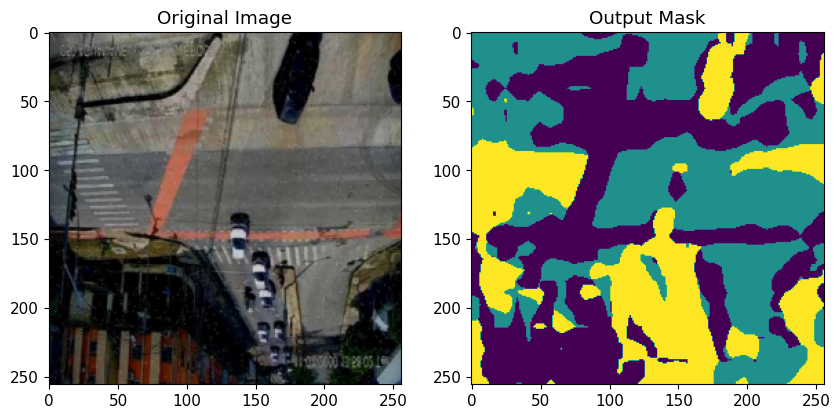

screenshot_3427_jpg.rf.cac8f7601c523332018b20f0e9fb4200.jpg


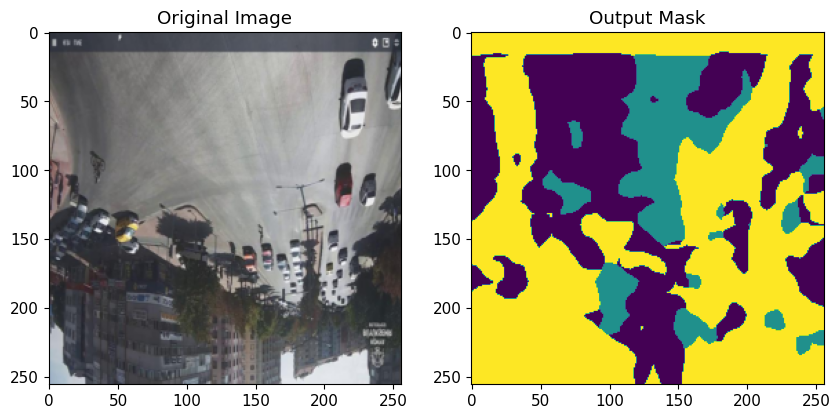

Epoch 5/25, Training Loss: 0.4517, Validation Loss: 0.3858
aguanambi-2530_png_jpg.rf.65a8ca3428f60cf705d1d0cfa008ec5c.jpg


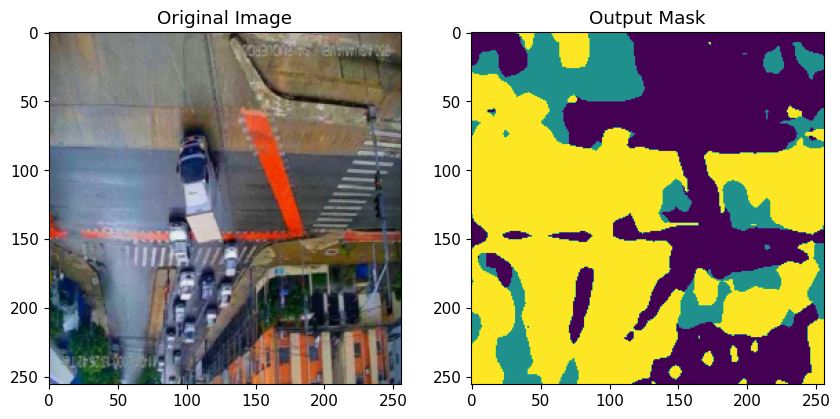

screenshot_8809_jpg.rf.09222b976b56fbc3f2c4e219b8871966.jpg


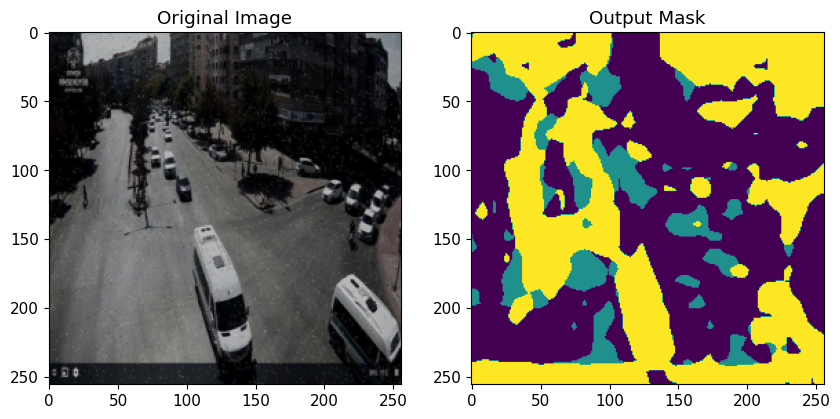

screenshot_10299_jpg.rf.d79ad25dd59f4556ee5ffadb71b2445e.jpg


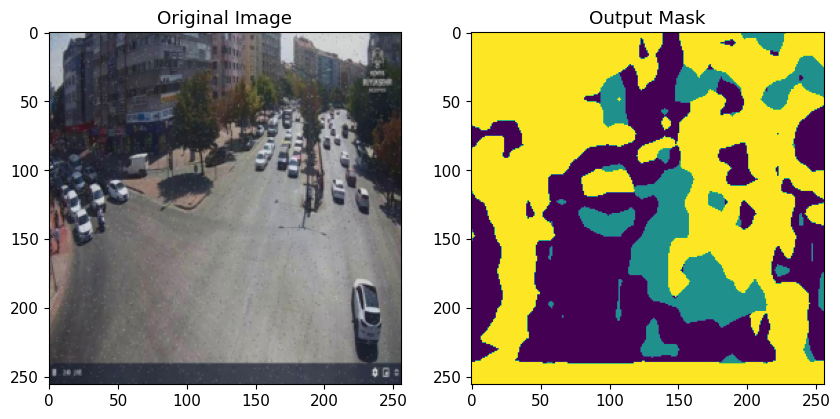

Epoch 6/25, Training Loss: 0.4234, Validation Loss: 0.3584
aguanambi-2980_png_jpg.rf.7250c039d53720cb5bf4bf2addbabd64.jpg


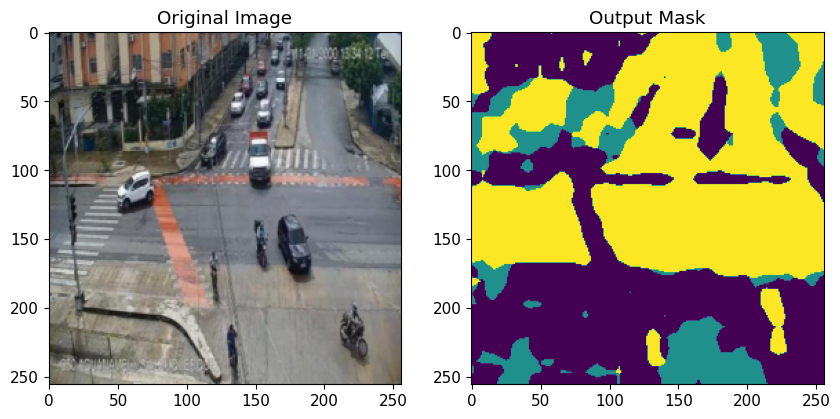

screenshot_15354_jpg.rf.43ace434875e8a3ec0e69d495b659cb0.jpg


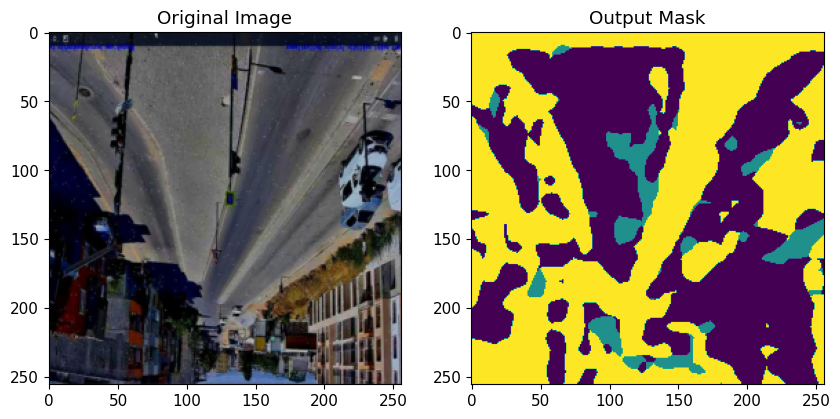

aguanambi-5550_png_jpg.rf.43574090400dd12e66f5e5ebc68a7748.jpg


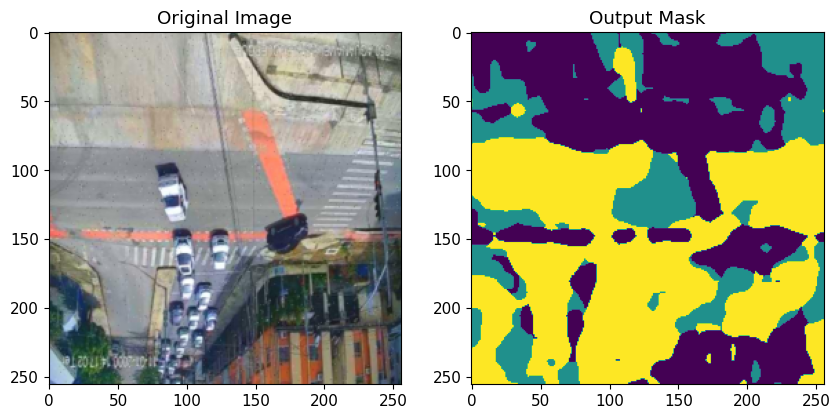

Epoch 7/25, Training Loss: 0.4209, Validation Loss: 0.3628
aguanambi-2415_png_jpg.rf.552f871b8501b129e6d19dc6256c8982.jpg


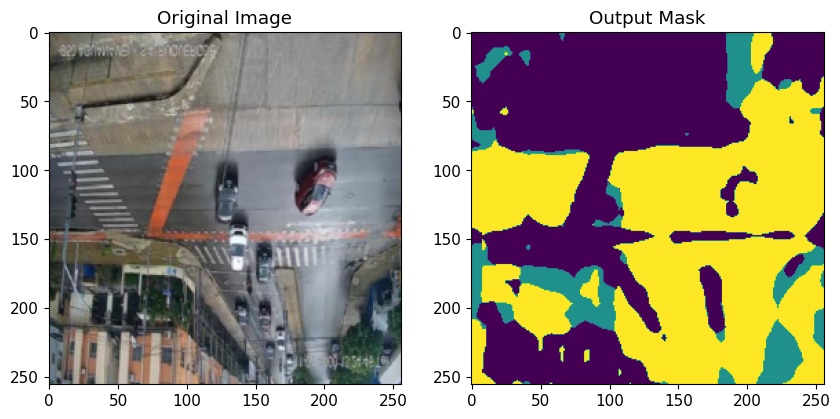

screenshot_5083_jpg.rf.4eae071c9512af7127514fa5610d6054.jpg


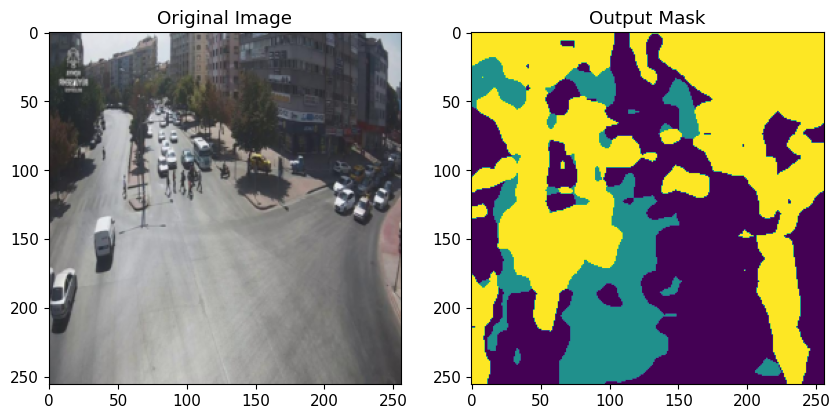

duque_de_caxias-290_png_jpg.rf.96e8edc86a5055e1b7785b22d6ac3496.jpg


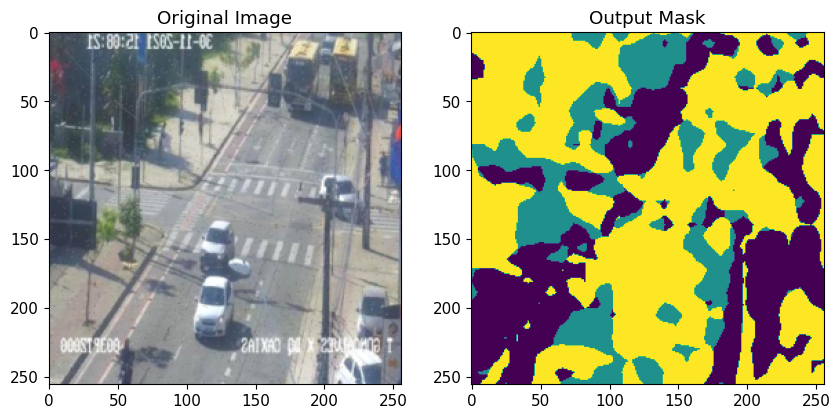

Epoch 8/25, Training Loss: 0.4181, Validation Loss: 0.3577
ant_sales-12150_png_jpg.rf.e1105b2ffd64eb3b9d6bdadeddd19967.jpg


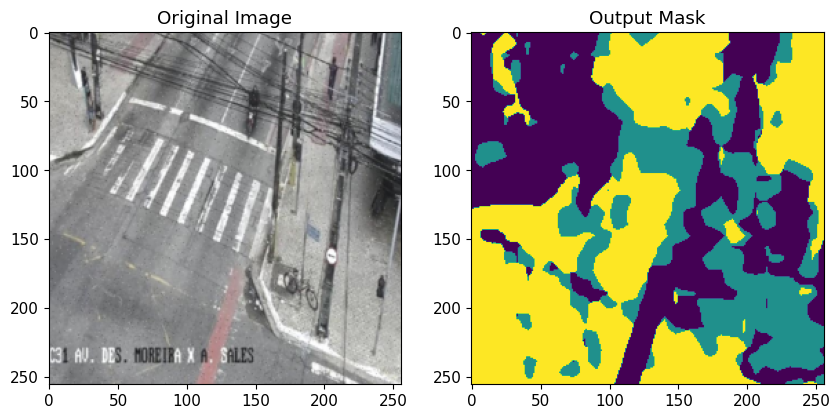

ant_sales-11845_png_jpg.rf.8cddf5f3e7436132c666d98b02b18f6b.jpg


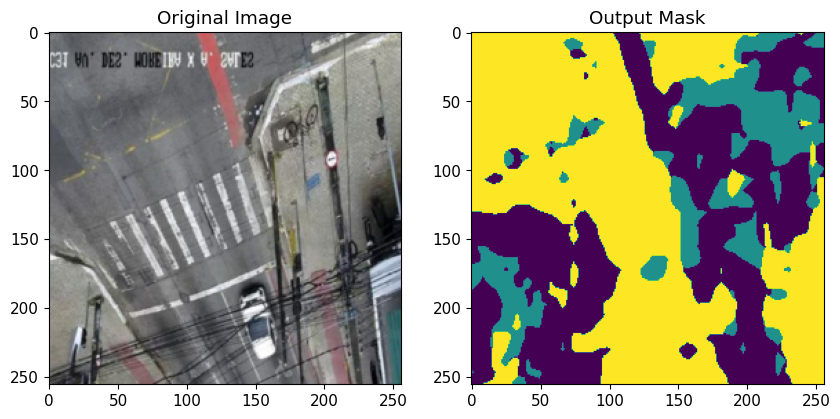

screenshot_27427_jpg.rf.d831e92d6af1742c80dfdb3f945972bf.jpg


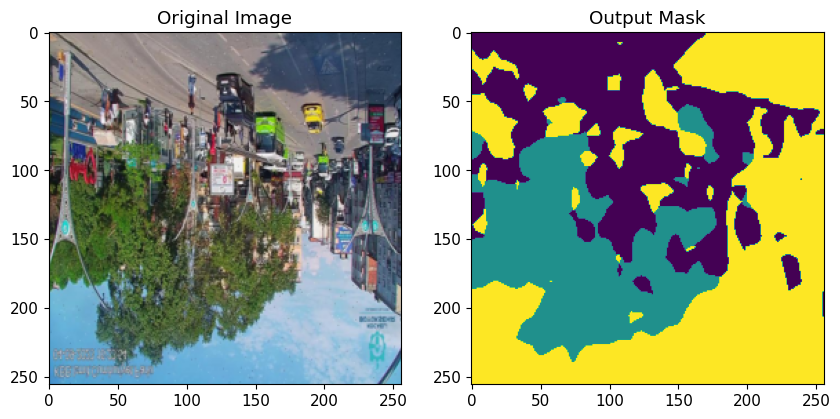

Epoch 9/25, Training Loss: 0.4170, Validation Loss: 0.3491
duque_de_caxias-2010_png_jpg.rf.98c057cd2d2909bb412c033256b45127.jpg


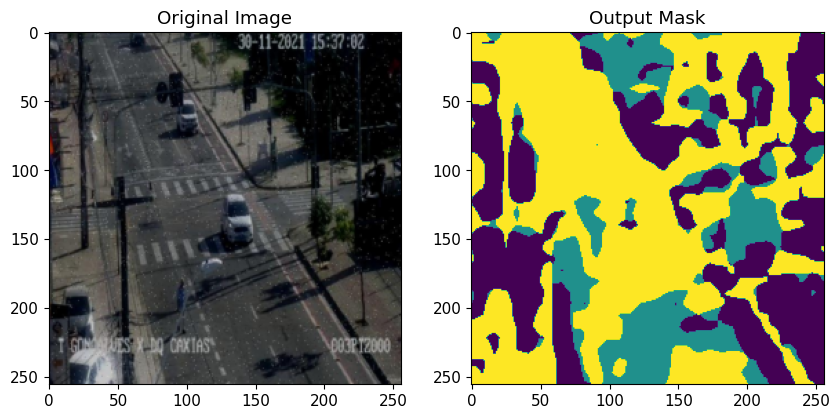

aguanambi-1555_png_jpg.rf.03e55fa69d3922e783cc46d3ac10eb9c.jpg


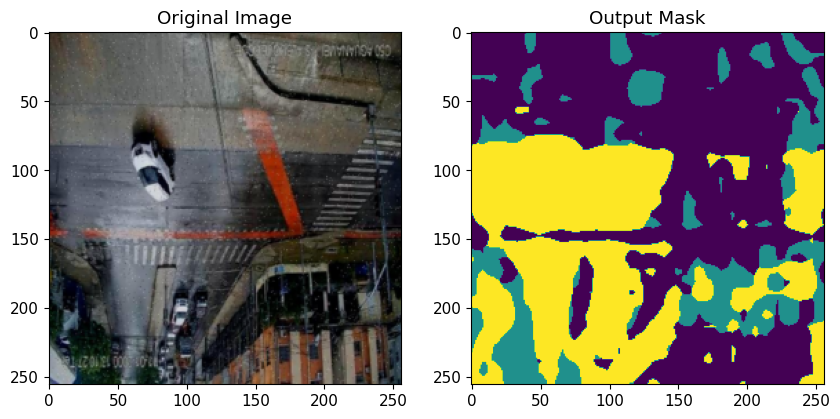

screenshot_6409_jpg.rf.8606f68773eaf312faad60c8f1302924.jpg


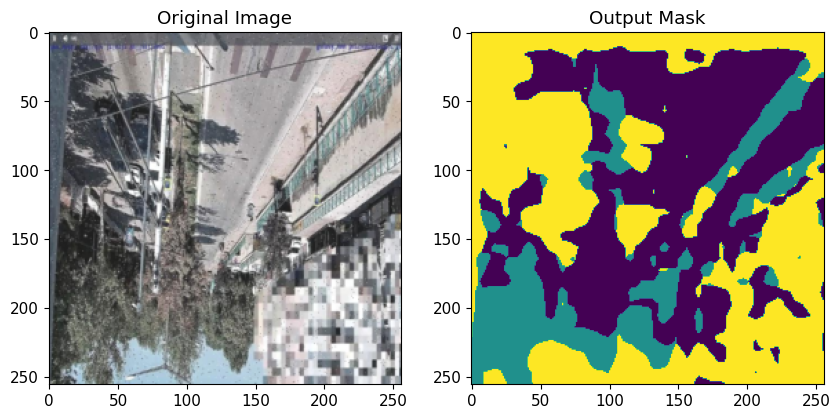

Epoch 10/25, Training Loss: 0.4150, Validation Loss: 0.3590
ant_sales-1000_png_jpg.rf.2d13d2f9cec197b2eac7d7dcadff5179.jpg


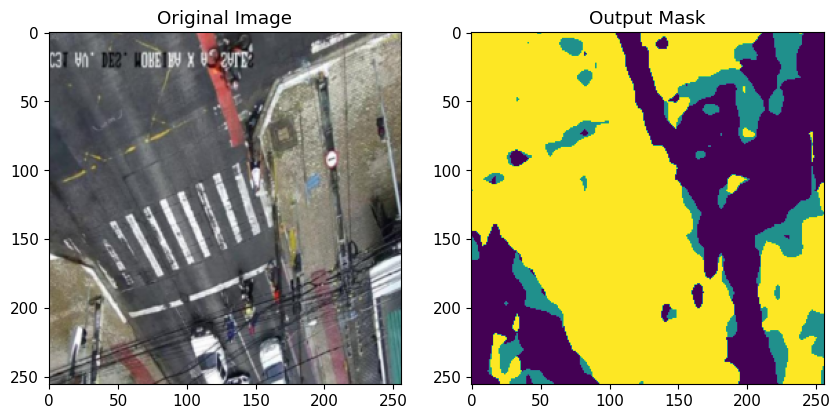

aguanambi-5265_png_jpg.rf.55fb2bea8375e099351d4b55a3c1f371.jpg


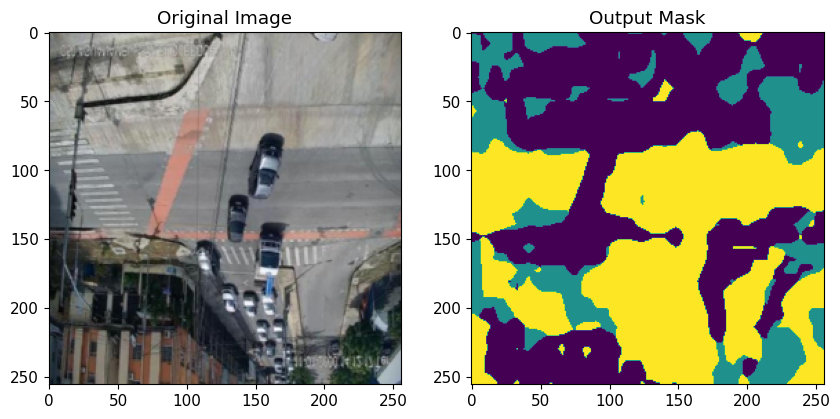

duque_de_caxias-700_png_jpg.rf.84a79d102a9382f7c6fafbcccda18acc.jpg


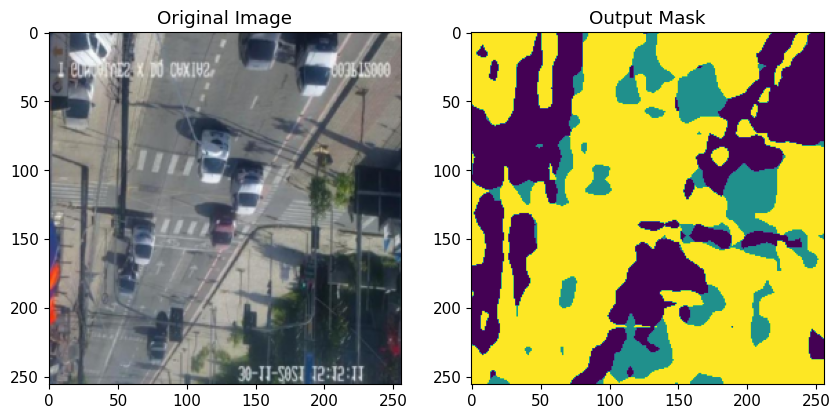

Epoch 11/25, Training Loss: 0.4114, Validation Loss: 0.3496
ant_sales-1040_png_jpg.rf.d35eabd5a96d8df0bd63864beb2a93f8.jpg


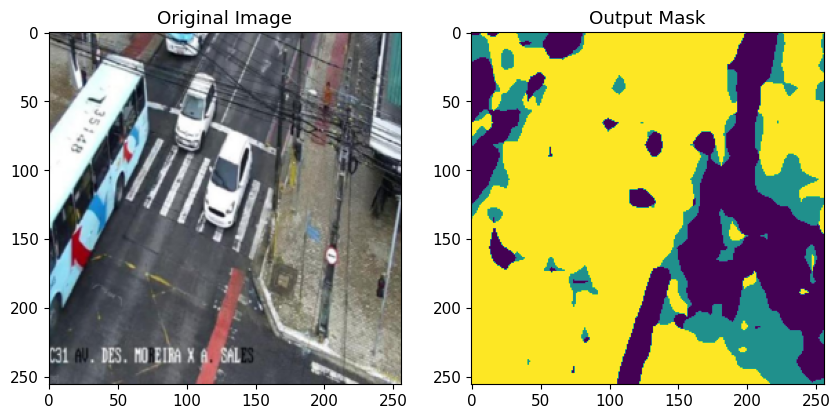

image62_png_jpg.rf.a8570791d12514a8aa804f2ca5e273f2.jpg


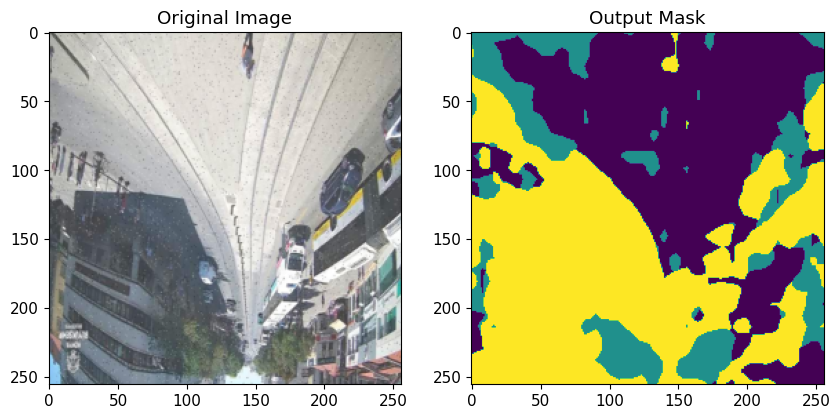

aguanambi-5410_png_jpg.rf.9e2532fa2c6c29a9b2a78001bb03696a.jpg


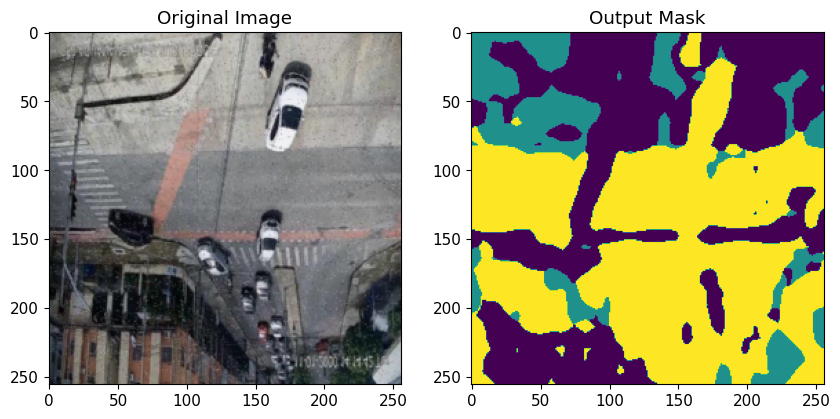

Epoch 12/25, Training Loss: 0.4133, Validation Loss: 0.3612
ant_sales-2610_png_jpg.rf.5f9338fc96548e6910095036d5cda761.jpg


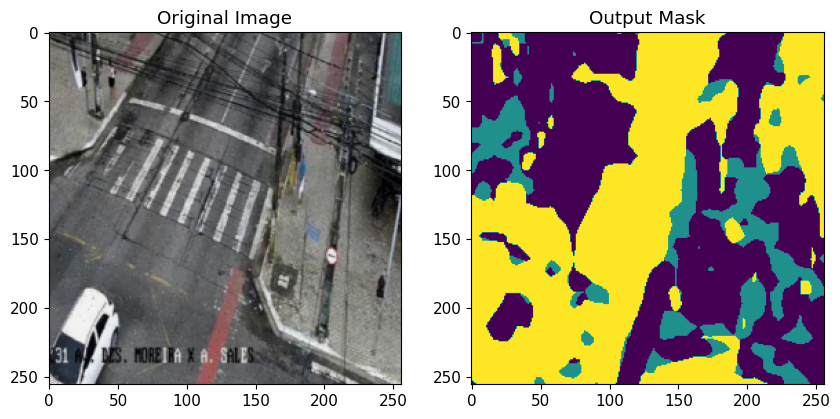

image92_png_jpg.rf.7b3b44fcc55ae5a7d6b94366e181571a.jpg


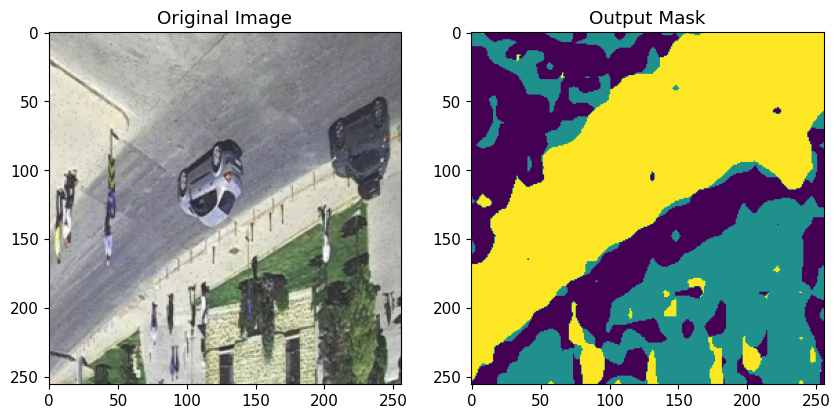

image45_png_jpg.rf.991376fd5826829826b6fef701352ba8.jpg


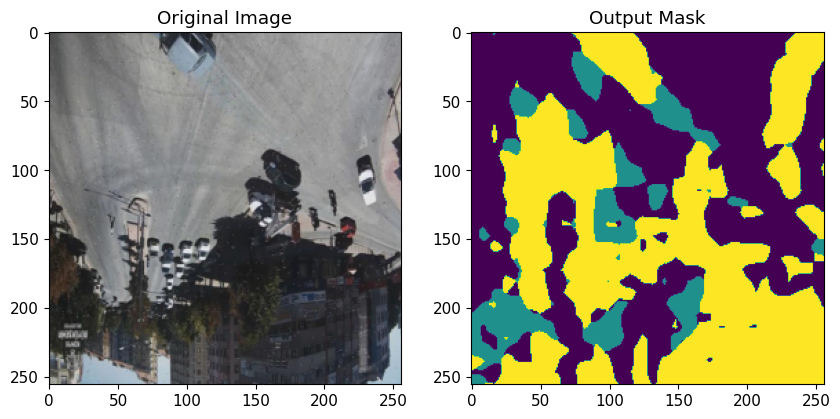

Epoch 13/25, Training Loss: 0.4116, Validation Loss: 0.3827
aguanambi-1235_png_jpg.rf.1a687e6535865912c21a3f4e52d498ca.jpg


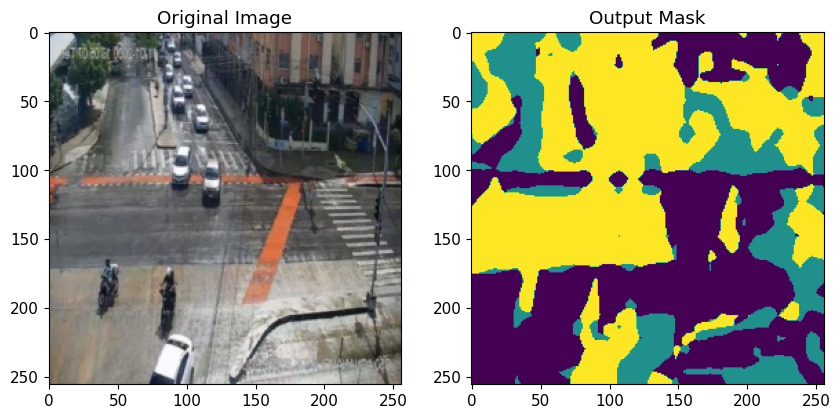

duque_de_caxias-315_png_jpg.rf.12aab71655ed5e004dbdfc03c579b9fb.jpg


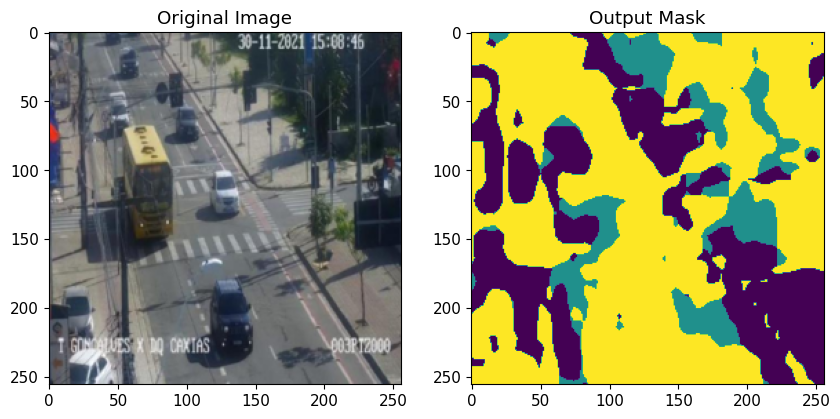

ant_sales-10995_png_jpg.rf.acee45cb144380a37e5a3403d013040e.jpg


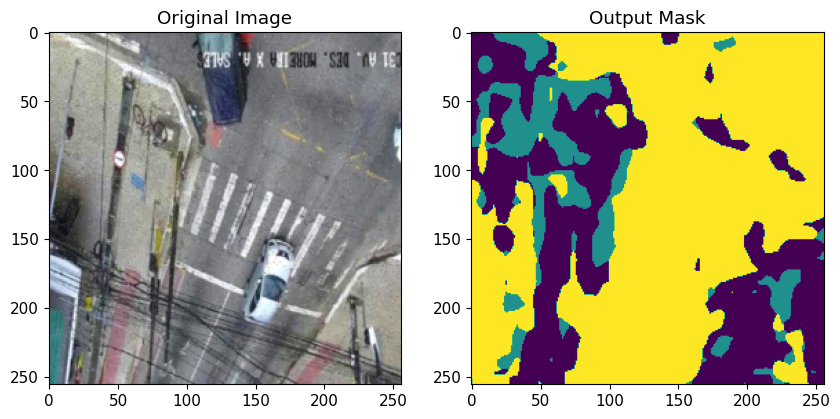

Epoch 14/25, Training Loss: 0.4107, Validation Loss: 0.3599
duque_de_caxias-2285_png_jpg.rf.ff467f13c1bdafc294fdff9f56a7c08c.jpg


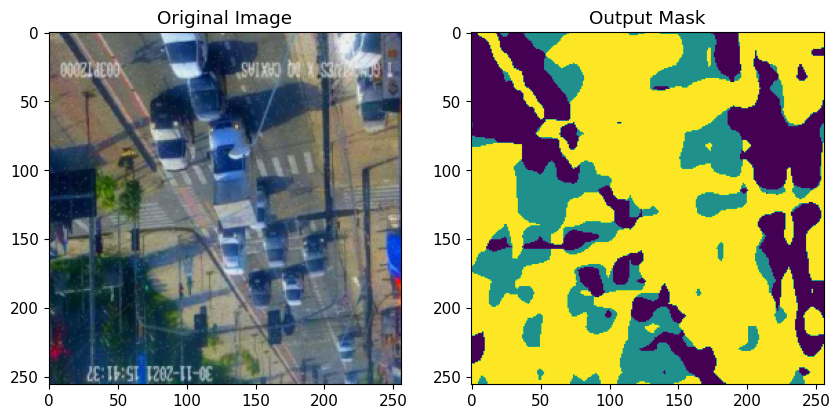

screenshot_23403_jpg.rf.47f66cccca468c6fffce6fa813c04541.jpg


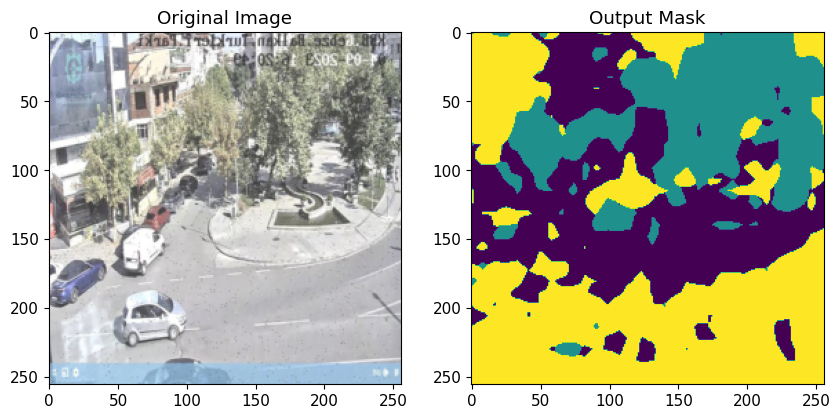

ant_sales-10020_png_jpg.rf.bf945138fb06a9e63bda93cd5ae6036b.jpg


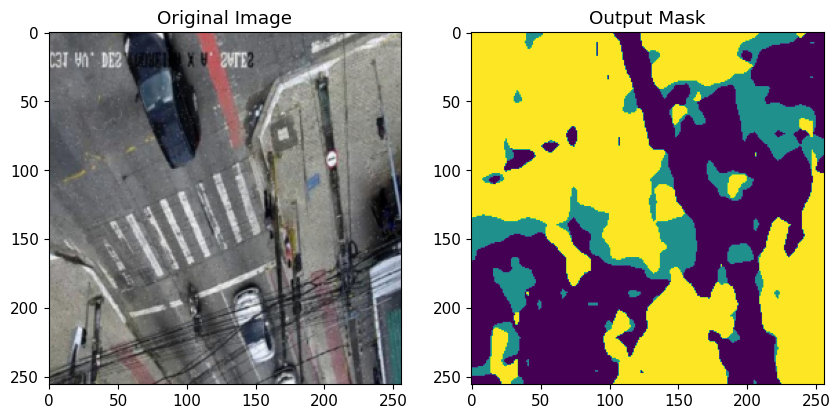

Epoch 15/25, Training Loss: 0.4115, Validation Loss: 0.3824
ant_sales-12275_png_jpg.rf.9496f5dc8a18210b348a6b6136c63c1f.jpg


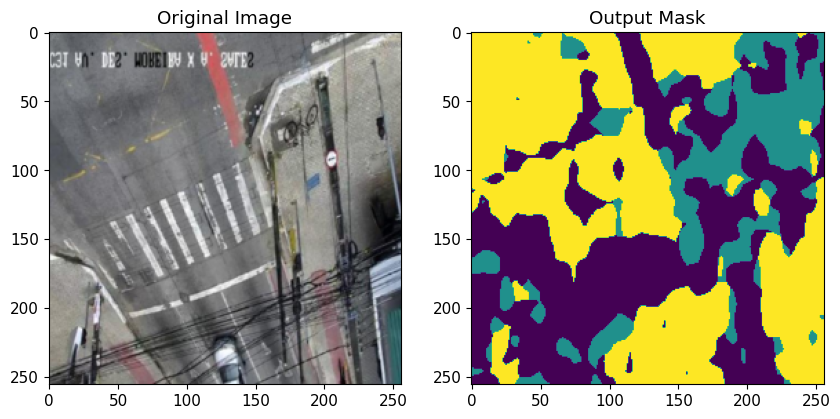

aguanambi-3120_png_jpg.rf.8cf85cb2a979b74fd81a7c7eee1acded.jpg


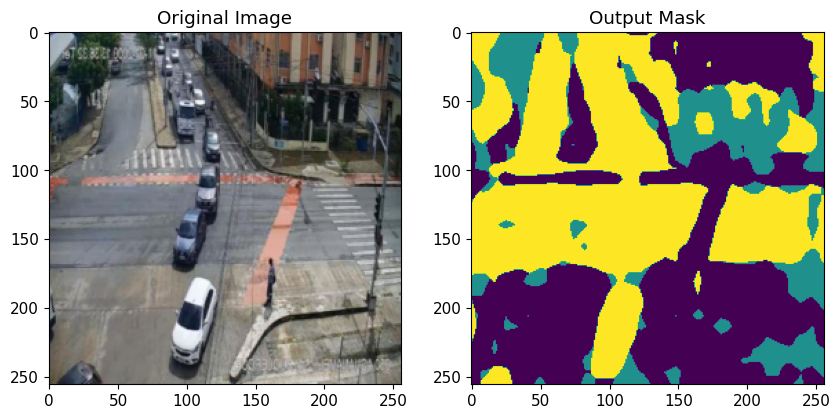

screenshot_12521_jpg.rf.d3b186309ae7713e2ef6ca90a7edd6f6.jpg


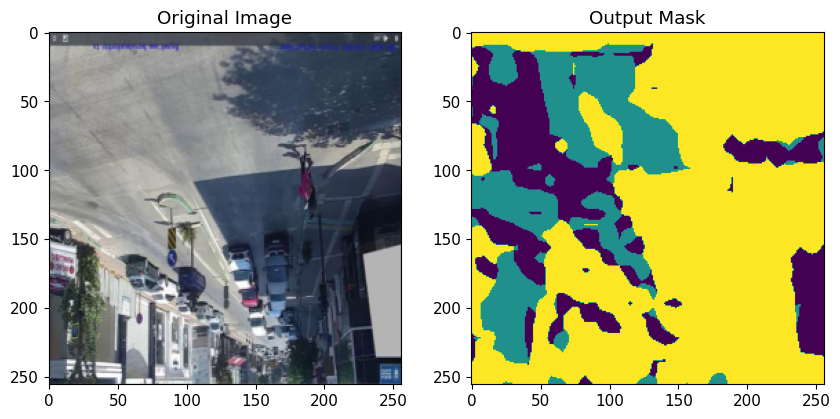

Epoch 16/25, Training Loss: 0.4126, Validation Loss: 0.3513
aguanambi-3860_png_jpg.rf.0dbd57980e7d6d3fefabe6f5862a1006.jpg


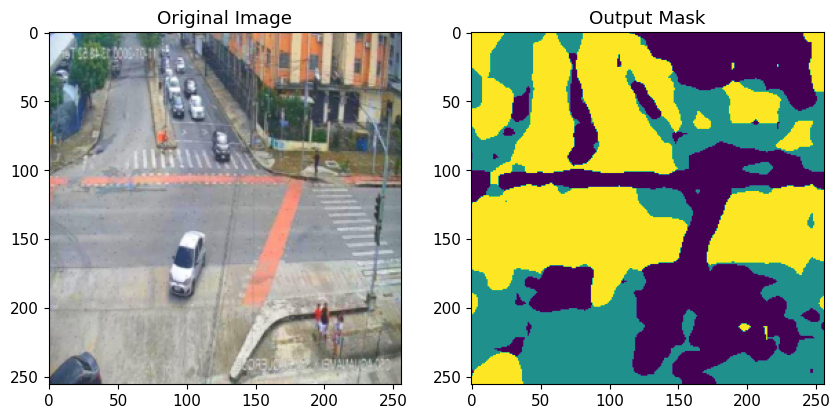

aguanambi-3820_png_jpg.rf.c1d2407af070ad90e98cb1c7dbb74297.jpg


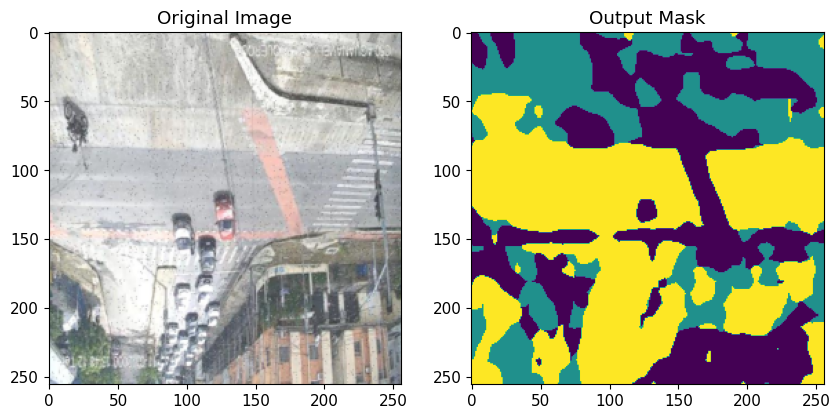

duque_de_caxias-2050_png_jpg.rf.37443960495b944c861b66b2ddc81a72.jpg


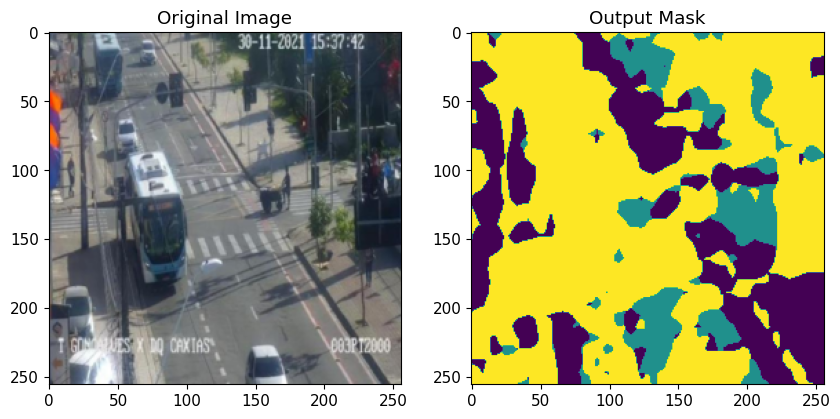

Epoch 17/25, Training Loss: 0.4106, Validation Loss: 0.3567
screenshot_4321_jpg.rf.aa8d6d98e27cbd7102940c7e50c3cf27.jpg


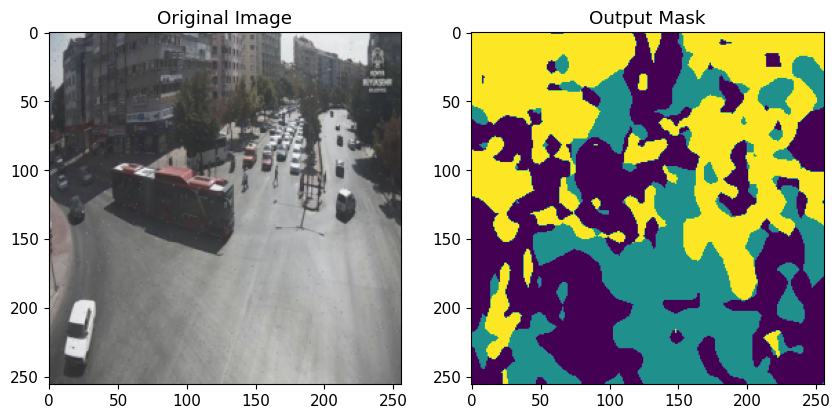

screenshot_28917_jpg.rf.65b72825f683f42ada73f8d22cdc92fc.jpg


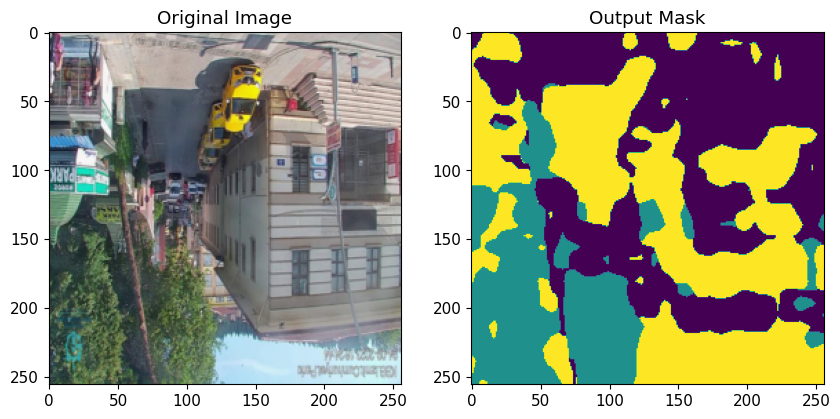

image04_png_jpg.rf.7096a053f88c128d90cba1b4d1058362.jpg


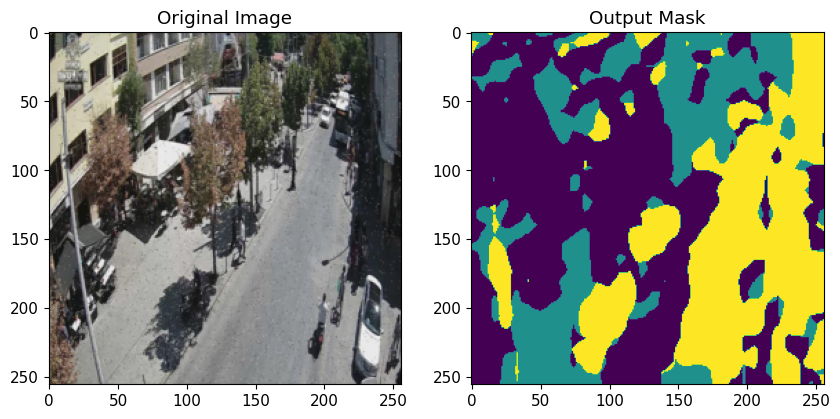

Epoch 18/25, Training Loss: 0.4118, Validation Loss: 0.3487
screenshot_18497_jpg.rf.6e36cc1a444b60ff1d3eb13318ab50ae.jpg


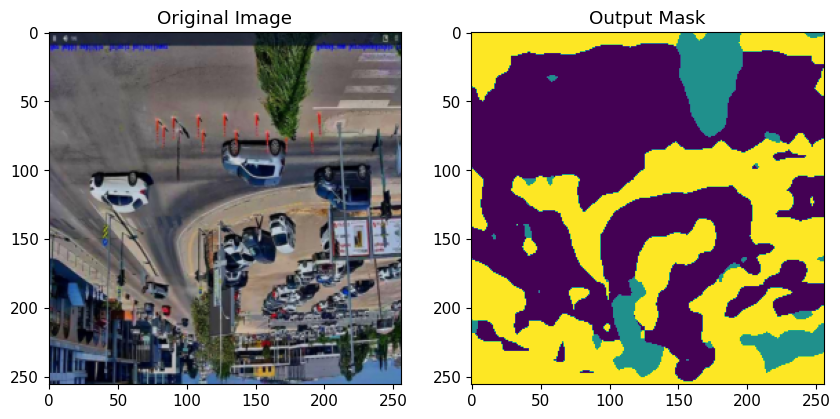

screenshot_10747_jpg.rf.a26780430c2e80b0f78f50bab80ef0a2.jpg


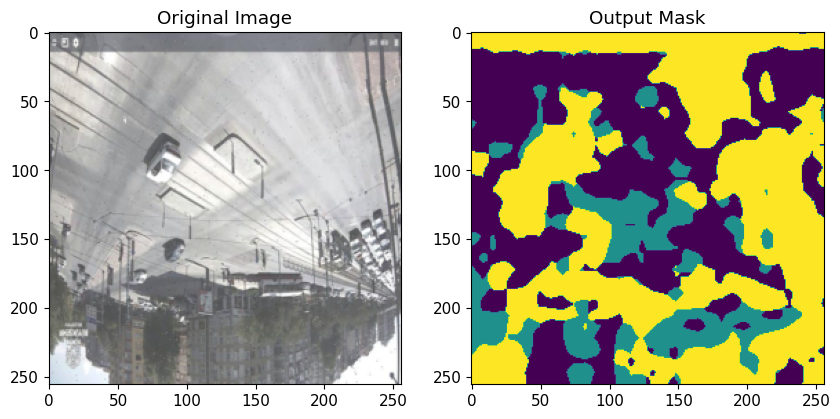

screenshot_6260_jpg.rf.7149445ea3c5f7424c74ea7bbd9c9d6e.jpg


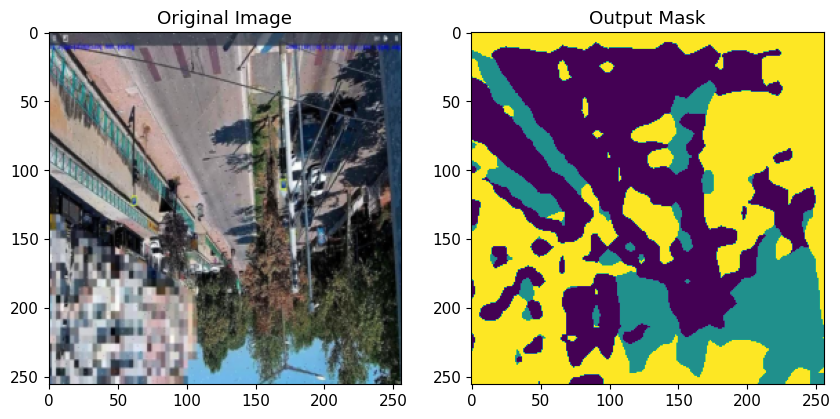

Epoch 19/25, Training Loss: 0.4096, Validation Loss: 0.3595
screenshot_3725_jpg.rf.e6b1c37ef70dd013fc8134350ab5fa3f.jpg


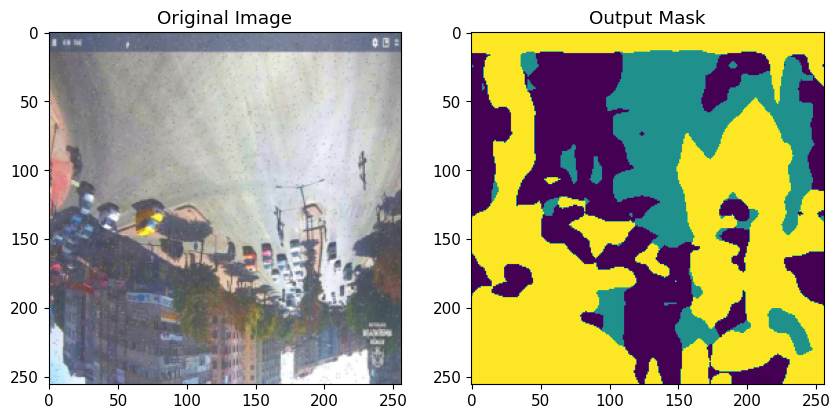

screenshot_7617_jpg.rf.91353756ab08371c33e15ee103a7292e.jpg


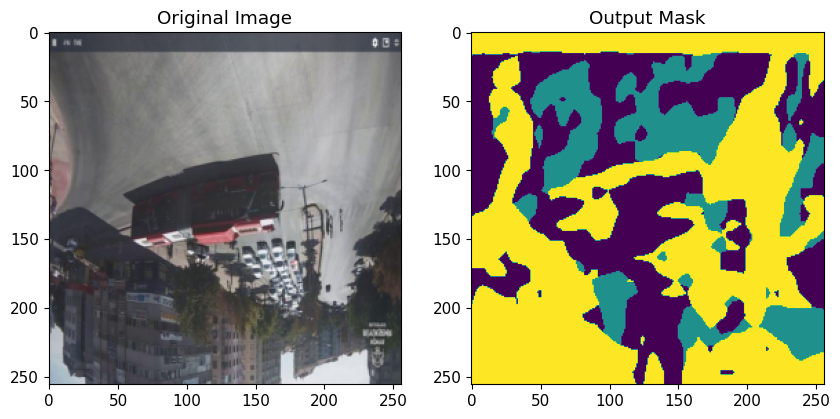

screenshot_7154_jpg.rf.f60b56dd3da6a01585fd5a1f4a1035d5.jpg


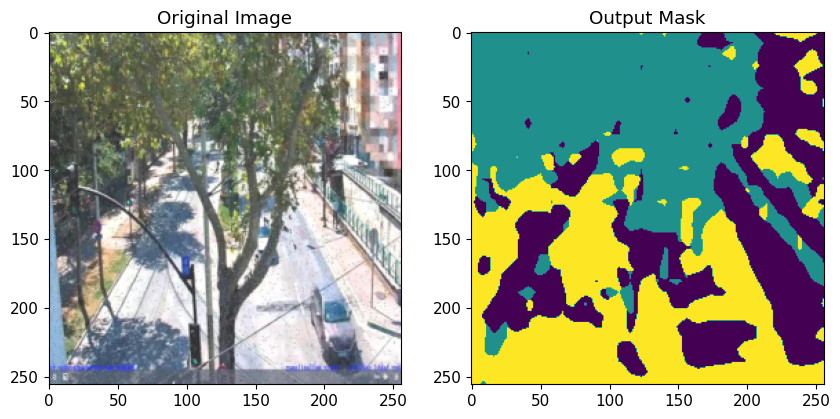

Epoch 20/25, Training Loss: 0.4118, Validation Loss: 0.3565
ant_sales-2350_png_jpg.rf.c76fb3385ebc0d9a76068d64b3fa4693.jpg


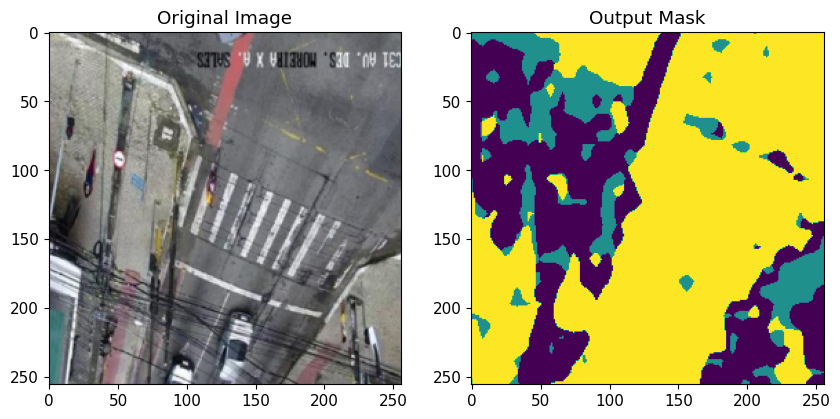

image36_png_jpg.rf.172f02618feebaac58a72814a5bc1ed7.jpg


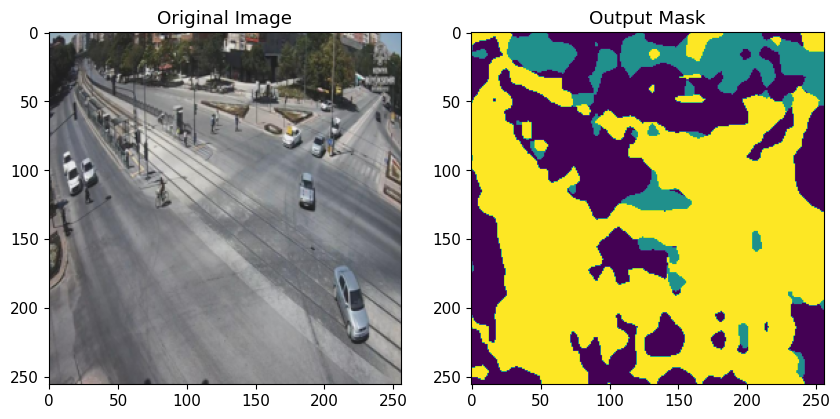

ant_sales-2315_png_jpg.rf.ed86ecd5ebd469bb30848b72f1b15e3e.jpg


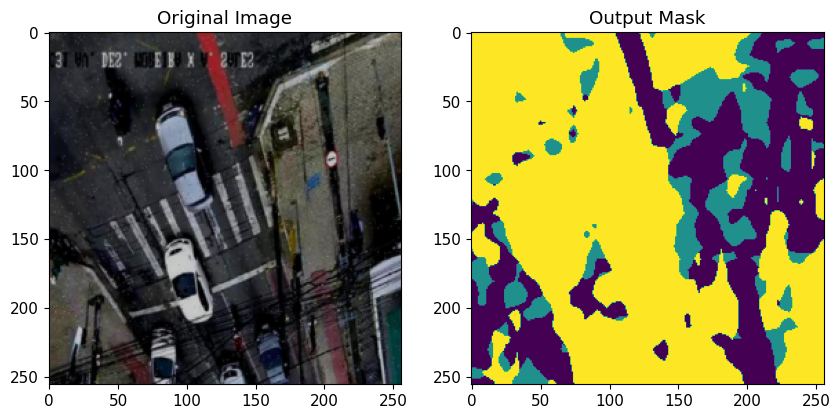

Epoch 21/25, Training Loss: 0.4108, Validation Loss: 0.3499
duque_de_caxias-565_png_jpg.rf.6221cdef457e258d4157e2a4dda80e6f.jpg


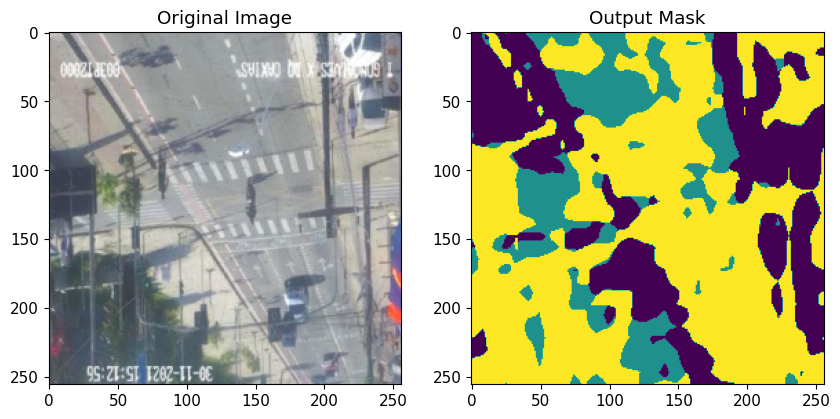

screenshot_35177_jpg.rf.b8a8154e03c3f413ec9d1a6d2ad6ab5c.jpg


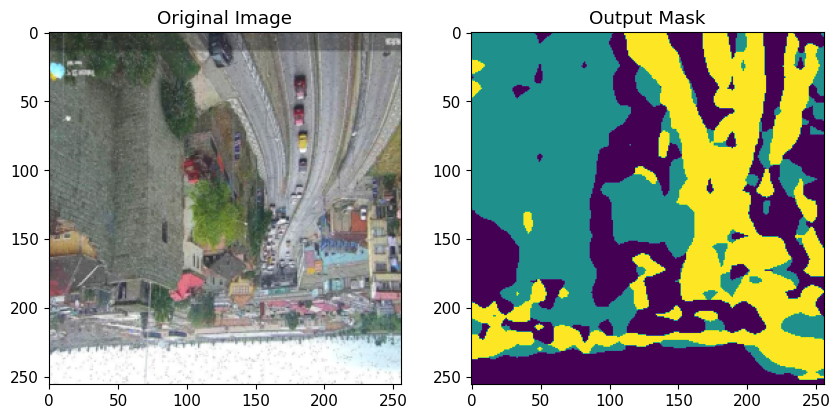

aguanambi-2850_png_jpg.rf.6535b5e9885d755216ddb808eee4ba75.jpg


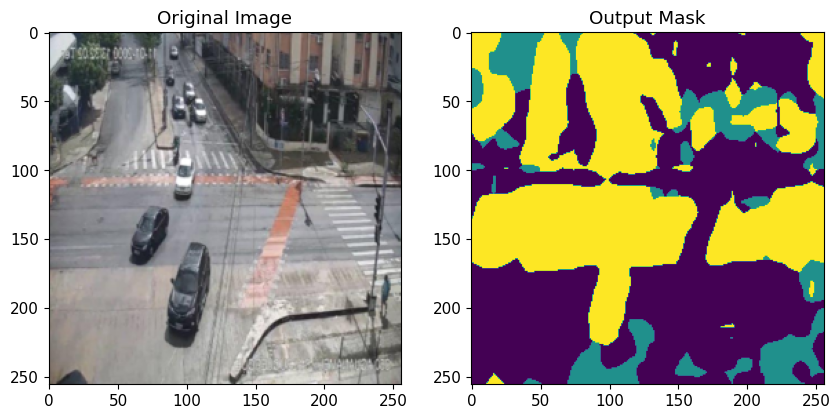

Epoch 22/25, Training Loss: 0.4092, Validation Loss: 0.3558
image53_png_jpg.rf.ee6b03375d886856a9bbe32f50d5f16d.jpg


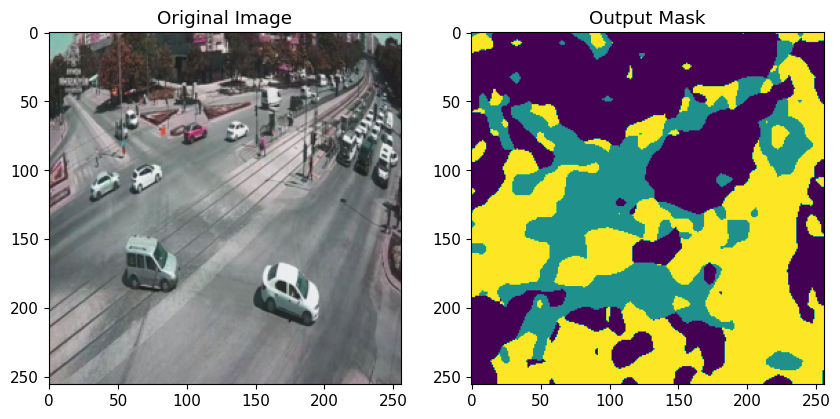

screenshot_14921_jpg.rf.266f9fe8560d4e79c7b54db54167d9e1.jpg


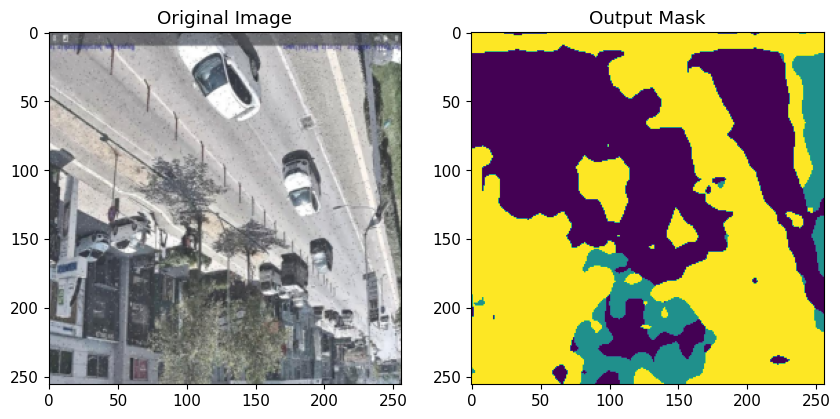

aguanambi-2530_png_jpg.rf.4a81cc0b2222d95c3bebe91116c097b5.jpg


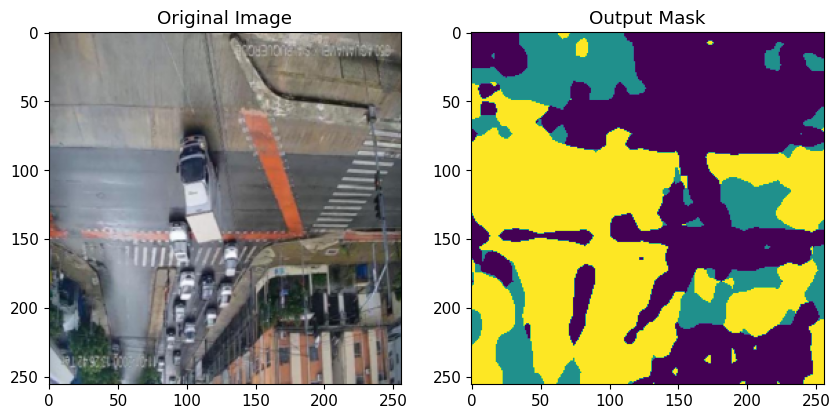

Epoch 23/25, Training Loss: 0.4087, Validation Loss: 0.3703
ant_sales-2350_png_jpg.rf.c76fb3385ebc0d9a76068d64b3fa4693.jpg


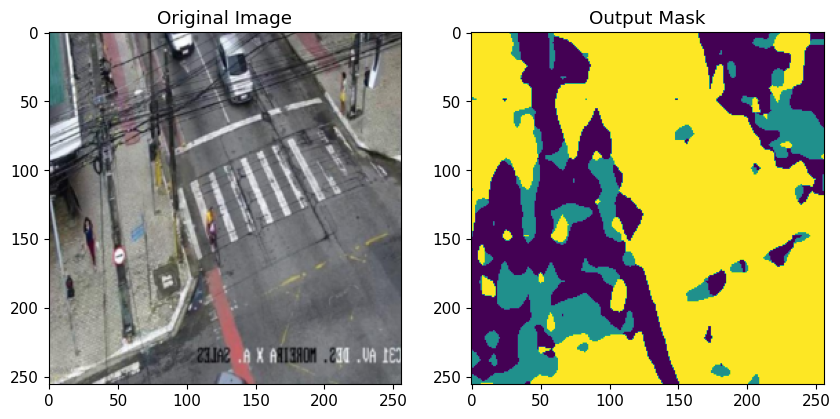

duque_de_caxias-835_png_jpg.rf.972faa69cb3756db1b35dd31a7c11cb3.jpg


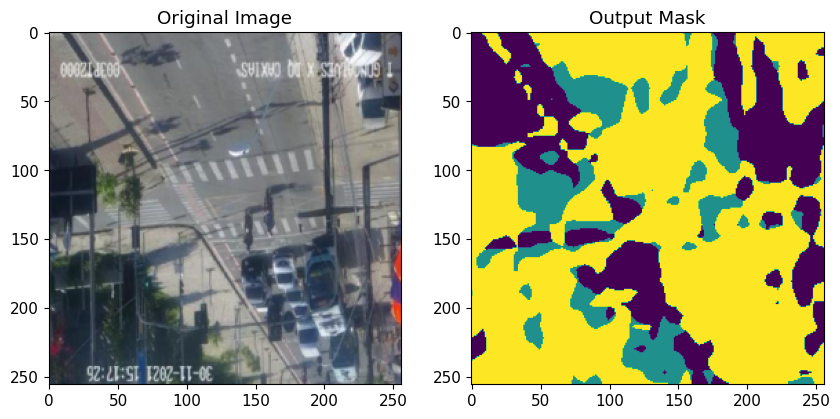

screenshot_23105_jpg.rf.66ebf733fbc5f7275e6c39de0f1fee4b.jpg


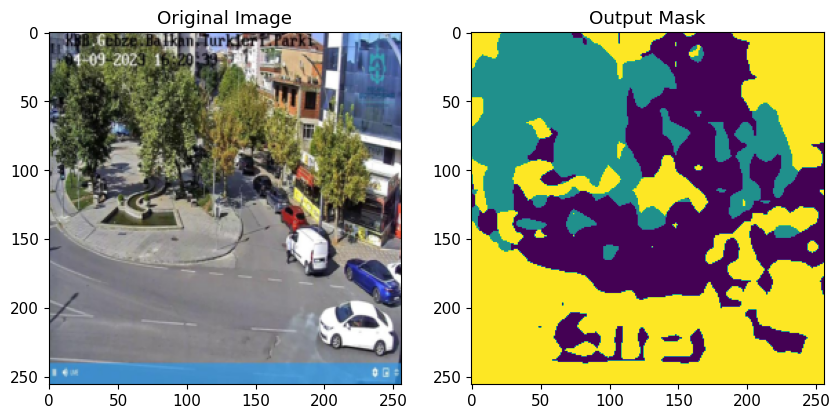

Epoch 24/25, Training Loss: 0.4106, Validation Loss: 0.3502
duque_de_caxias-720_png_jpg.rf.56fe954cd6b50888a23e5cec7b6b6ac9.jpg


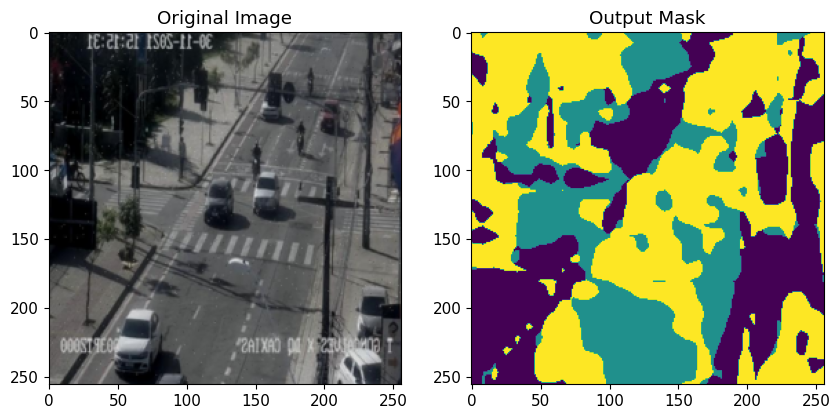

ant_sales-11885_png_jpg.rf.f677625f3fac9eabc6f6a0589aabdddd.jpg


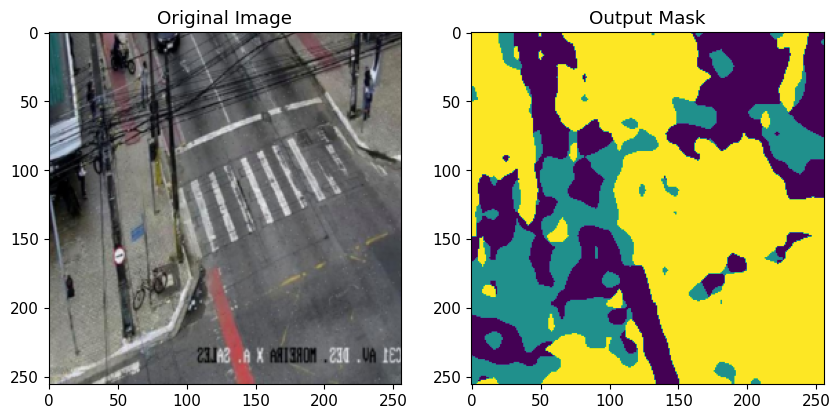

screenshot_14921_jpg.rf.1257425c4be48bb39ba45f2cb6afffbd.jpg


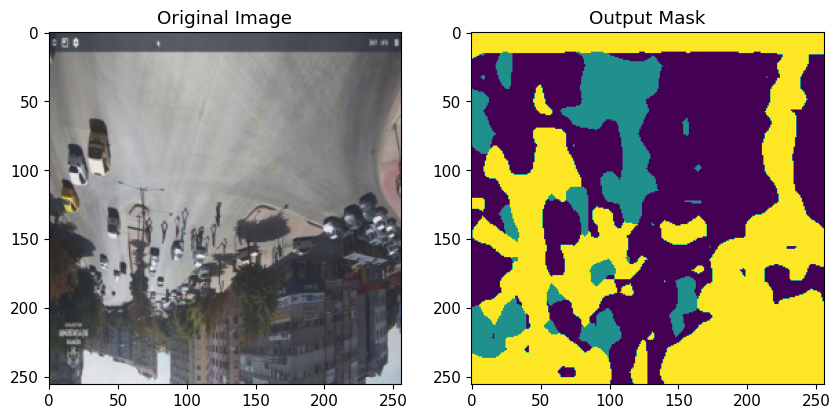

Epoch 25/25, Training Loss: 0.4101, Validation Loss: 0.3518


In [20]:
%matplotlib inline

# Set the device (GPU if available, otherwise CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the YOLOv5 model and convert its parameters to float32
yolov5_model = torch.load('./yolov5s.pt', map_location=device)['model']
yolov5_model = yolov5_model.to(torch.float32)  # Convert to float32
# print(yolov5_model)

# Create the YOLO encoder
yolo_encoder = YoloEncoder(yolov5_model).to(device)

# Instantiate your custom model
model = UNetWithYoloEncoder(yolo_encoder, n_classes=5)  # Adjust the number of classes accordingly
model.to(device)

# Load the state dictionary into your custom model
state_dict = torch.load('./mymodel.pth', map_location=device)
model.load_state_dict(state_dict, strict=False)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

num_epochs = 25  # Set the number of epochs

for epoch in range(num_epochs):
    model.train()  # Set the model to training mode
    running_loss = 0.0

    for i, (inputs, names) in enumerate(data_loader):  # No need to unpack targets
        inputs = inputs.to(device)  # Send inputs to GPU if available

        optimizer.zero_grad()
        outputs = model(inputs)

        # Convert one-hot encoded or class-dimensioned inputs to class indices
        inputs_indices = torch.argmax(inputs, dim=1)


        loss = loss_fn(outputs, inputs_indices)  # Loss calculated between model output and original input
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        # Visualization and printing code...
        if i % 700 == 0:
            image_name = names[0]
            # Convert the batch to CPU and detach it
            inputs_cpu = inputs.cpu().detach()
            outputs_cpu = outputs.cpu().detach()

            # Display the first image in the batch
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            imshow_normalized(inputs_cpu[0])
            plt.title("Original Image")
            print(image_name)


            plt.subplot(1, 2, 2)
            imshow_normalized(outputs_cpu[0], is_mask=True)
            plt.title("Output Mask")

            plt.show()
            plt.close()

    epoch_loss = running_loss / len(data_loader)

    # Start validation
    model.eval()  # Set the model to evaluation mode
    val_loss = 0.0
    with torch.no_grad():  # No gradient computation in validation phase
        for i, (val_inputs, names) in enumerate(valid_loader):
            val_inputs = val_inputs.to(device)
            val_outputs = model(val_inputs)
            
            val_inputs_indices = torch.argmax(val_inputs, dim=1)
            loss = loss_fn(val_outputs, val_inputs_indices)
            val_loss += loss.item()

    avg_val_loss = val_loss / len(valid_loader)
    print(f'Epoch {epoch+1}/{num_epochs}, Training Loss: {epoch_loss:.4f}, Validation Loss: {avg_val_loss:.4f}')
    scheduler.step()


aguanambi-1000_png_jpg.rf.7179a0df58ad6448028bc5bc21dca41e.jpg


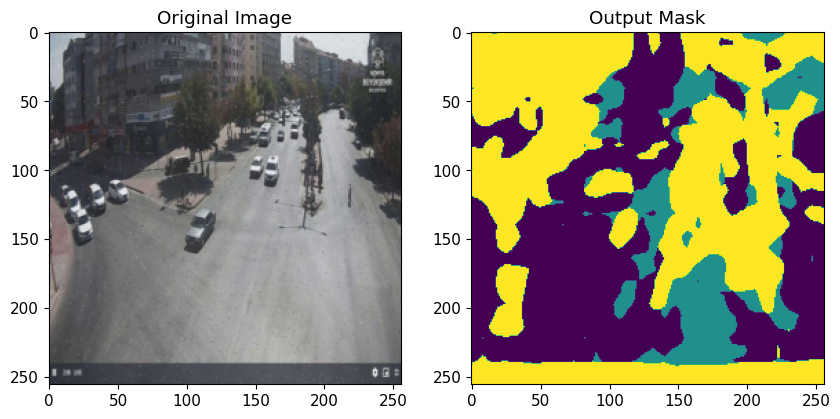

ant_sales-2185_png_jpg.rf.ef9570c136e91a3119c09d600c86a4a3.jpg


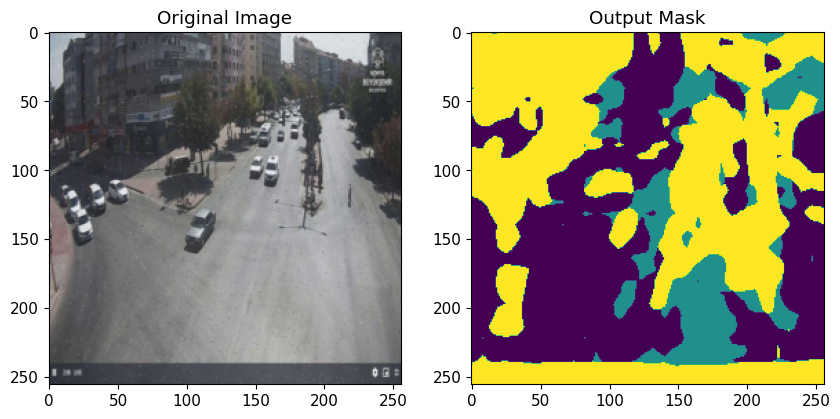

screenshot_11030_jpg.rf.74c2874cac4916f2e472aeb6437bd2ec.jpg


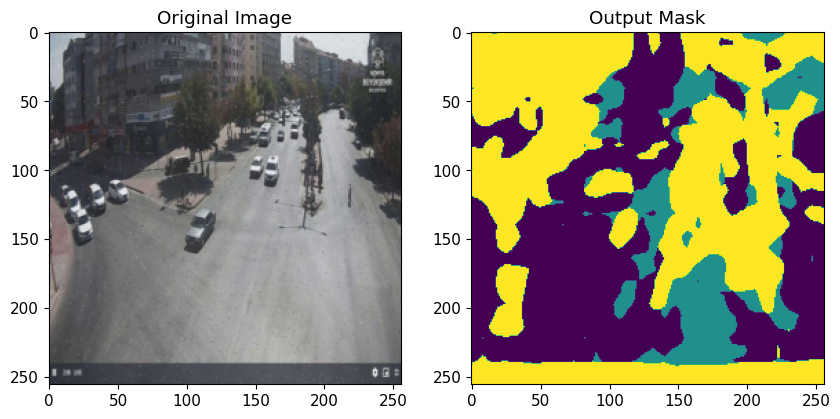

Test Loss: 0.3494


In [21]:
model.eval()  # Set the model to evaluation mode
test_loss = 0.0
predictions = []
original_images = []

with torch.no_grad():  # No gradient computation in test phase
    for i,(test_inputs, names) in enumerate(test_dataloader):
        test_inputs = test_inputs.to(device)
        test_outputs = model(test_inputs)

        test_inputs_indices = torch.argmax(test_inputs, dim=1)
        loss = loss_fn(test_outputs, test_inputs_indices)
        test_loss += loss.item()

        # Visualization and printing code...
        if i % 100 == 0:
            image_name = names[0]
            # Convert the batch to CPU and detach it
            inputs_cpu = inputs.cpu().detach()
            outputs_cpu = outputs.cpu().detach()

            # Display the first image in the batch
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            imshow_normalized(inputs_cpu[0])
            plt.title("Original Image")
            print(image_name)


            plt.subplot(1, 2, 2)
            imshow_normalized(outputs_cpu[0], is_mask=True)
            plt.title("Output Mask")

            plt.show()
            plt.close()

avg_test_loss = test_loss / len(test_dataloader)
print(f'Test Loss: {avg_test_loss:.4f}')
